# PCA from Scratch

DS 5001 Text as Data

**Purpose:**  To implement PCA from scratch and explore application to Austen-Melville corpus.

# Set Up

## Import

In [1]:
import pandas as pd
import numpy as np
from scipy.linalg import norm

In [2]:
import plotly_express as px
import seaborn as sns

In [3]:
sns.set(style='ticks')

## Config

In [4]:
import configparser
config = configparser.ConfigParser()
config.read("../../../env.ini")
data_home = config['DEFAULT']['data_home']
output_dir = config['DEFAULT']['output_dir']
local_lib = config['DEFAULT']['local_lib']

In [5]:
data_prefix = 'austen-melville'

In [6]:
OHCO = ['book_id', 'chap_id']

In [7]:
# Added after class
norm_docs = False # This has the effect of exaggerating variance when False
center_term_vectors = False # This has the effect of demoting authorship when False

We pick a color map for our gradient visualizations. For more info on color maps, see the [Matplotlib docs](https://matplotlib.org/stable/tutorials/colors/colormaps.html) on the subject.

In [8]:
colors = "YlGnBu" 
# colors = "Spectral"

# Prepare the Data

## Import tables

**Downloads**

- [austen-melville-VOCAB2.csv](https://www.dropbox.com/scl/fi/u4t0o5zpoaunyi4l5dklr/austen-melville-VOCAB2.csv?rlkey=5m3fiuucraflg4ntoxqc0t3hv&dl=0)
- [austen-melville-LIB_LABELS.csv](https://www.dropbox.com/scl/fi/f63v0pjqemsody71c9sun/austen-melville-LIB_LABELS.csv?rlkey=0ue1mz9x2ycqybcwti0vsnm9y&dl=0)
- [austen-melville-BOW-CHAPS.csv](https://www.dropbox.com/scl/fi/jykn79w6zfr26bushqoda/austen-melville-BOW-CHAPS.csv?rlkey=c36zwn53lcnsa98crqwb8lozc&dl=0)

In [9]:
LIB = pd.read_csv(f'{output_dir}/{data_prefix}-LIB_LABELS.csv').set_index('book_id')
VOCAB = pd.read_csv(f'{output_dir}/{data_prefix}-VOCAB.csv').set_index('term_str')
BOW = pd.read_csv(f'{output_dir}/{data_prefix}-BOW-CHAPS.csv').set_index(OHCO+['term_str'])

In [10]:
VOCAB[['n','p','i']].head(20)

,n,p,i
term_str,,,
the,109921,0.053387,4.227375
of,65525,0.031824,4.973725
and,62954,0.030576,5.031473
to,56271,0.027330,5.193379
a,44174,0.021455,5.542573
in,36439,0.017698,5.820287
i,27280,0.013249,6.237927
was,24231,0.011769,6.408917
that,23670,0.011496,6.442711


## Generate reduced `TFIDF` table

We reduce the feature space of the the TFIDF table by selecting the top 1000 significant nouns, verbs, and adjectives.

Note that the `TFIDF` table is an extension of an implied `DOC` table, where each doc is a chapter in this case.

In [11]:
# VOCAB.max_pos_group.value_counts()

In [11]:
TFIDF = BOW['tfidf'].unstack(fill_value=0)

In [12]:
VOCAB['df'] = TFIDF.astype(bool).sum()

In [13]:
VOCAB['dfidf'] = VOCAB.df * np.log2(len(TFIDF)/VOCAB.df)

In [14]:
pos_set = ['NN', 'VB']

In [15]:
VSHORT = VOCAB[VOCAB.max_pos_group.isin(['NN', 'VB', 'JJ']) & ~VOCAB.max_pos.isin(['NNP'])].sort_values('dfidf', ascending=False).head(5000)

In [16]:
TFIDF = TFIDF[VSHORT.index]

In [17]:
TFIDF

term_str             home     cried   certain   looking   general    manner  \
book_id chap_id                                                               
105     1        0.001097  0.000000  0.000553  0.000000  0.000000  0.000000   
        2        0.002187  0.000000  0.000000  0.000743  0.000000  0.000746   
        3        0.001522  0.001012  0.000512  0.001033  0.000000  0.000000   
        4        0.001595  0.000000  0.000805  0.000000  0.001632  0.000816   
        5        0.000866  0.000000  0.000000  0.000883  0.000000  0.001773   
...                   ...       ...       ...       ...       ...       ...   
34970   110      0.000000  0.002182  0.000000  0.000000  0.000000  0.000000   
        111      0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
        112      0.002184  0.000000  0.000000  0.000000  0.000000  0.000000   
        113      0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
        114      0.000000  0.004452  0.000000  0.000000  0.000000  0.000000   

term_str             felt       set        oh     times  ...  bargain  breed  \
book_id chap_id                                          ...                   
105     1        0.002244  0.000538  0.000000  0.000000  ...      0.0    0.0   
        2        0.002238  0.000000  0.000000  0.000000  ...      0.0    0.0   
        3        0.000000  0.001494  0.000992  0.000496  ...      0.0    0.0   
        4        0.000816  0.000000  0.000000  0.000000  ...      0.0    0.0   
        5        0.001330  0.001701  0.002540  0.001270  ...      0.0    0.0   
...                   ...       ...       ...       ...  ...      ...    ...   
34970   110      0.002238  0.000000  0.000000  0.000000  ...      0.0    0.0   
        111      0.000000  0.000000  0.003893  0.000000  ...      0.0    0.0   
        112      0.000000  0.000000  0.000000  0.000000  ...      0.0    0.0   
        113      0.000000  0.000000  0.011104  0.000000  ...      0.0    0.0   
        114      0.000000  0.000000  0.008723  0.000000  ...      0.0    0.0   

term_str         regretting  conference  attendant  upstairs  sunshine  \
book_id chap_id                                                          
105     1               0.0    0.000000        0.0       0.0       0.0   
        2               0.0    0.000000        0.0       0.0       0.0   
        3               0.0    0.002027        0.0       0.0       0.0   
        4               0.0    0.000000        0.0       0.0       0.0   
        5               0.0    0.000000        0.0       0.0       0.0   
...                     ...         ...        ...       ...       ...   
34970   110             0.0    0.000000        0.0       0.0       0.0   
        111             0.0    0.000000        0.0       0.0       0.0   
        112             0.0    0.000000        0.0       0.0       0.0   
        113             0.0    0.000000        0.0       0.0       0.0   
        114             0.0    0.000000        0.0       0.0       0.0   

term_str         traveler  seclusion  promoted  
book_id chap_id                                 
105     1             0.0        0.0  0.002191  
        2             0.0        0.0  0.000000  
        3             0.0        0.0  0.000000  
        4             0.0        0.0  0.000000  
        5             0.0        0.0  0.000000  
...                   ...        ...       ...  
34970   110           0.0        0.0  0.000000  
        111           0.0        0.0  0.000000  
        112           0.0        0.0  0.000000  
        113           0.0        0.0  0.000000  
        114           0.0        0.0  0.000000  

[1185 rows x 5000 columns]

## Add some labels to `LIB`

In [18]:
genre_csv = """
105, domestic, romance
121, gothic, satire
141, domestic, satire
158, domestic, romance
161, domestic, romance
946, domestic, romance
1212, domestic, satire
1342, domestic, romance
1900, travel, adventure
2701, sea, adventure
4045, travel, adventure
8118, sea, adventure
10712, sea, critical
13720, sea, adventure
13721, sea, adventure
15422, historical, adventure
15859, mixed, mixed
21816, travel, satire
34970, gothic, psychological
53861, mixed, mixed
""".split('\n')[1:-1]
genre = pd.DataFrame([line.split(', ') for line in genre_csv], columns=['book_id','genre', 'mode'])
genre.book_id = genre.book_id.astype('int')
genre = genre.set_index('book_id')

In [19]:
LIB = pd.concat([LIB, genre], axis=1)

In [20]:
LIB_COLS = ['author','title', 'label', 'genre', 'mode']

In [21]:
LIB[LIB_COLS].head()

,author,title,label,genre,mode
book_id,,,,,
105,"AUSTEN, JANE",PERSUASION,Austen: Persuasion (105),domestic,romance
121,"AUSTEN, JANE",NORTHANGER ABBEY,Austen: Northanger Abbey (121),gothic,satire
141,"AUSTEN, JANE",MANSFIELD PARK,Austen: Mansfield Park (141),domestic,satire
158,"AUSTEN, JANE",EMMA,Austen: Emma (158),domestic,romance
161,"AUSTEN, JANE",SENSE AND SENSIBILITY,Austen: Sense And Sensibilit (161),domestic,romance


# PCA Process

## Normalize doc vector lengths

We use L2 normalization, which scales documents by their pythagorean (Euclidean) length.

In [22]:
# TFIDF_L2 = (TFIDF.T / np.sqrt(np.square(TFIDF).sum(axis=1))).T
TFIDF_L2 = (TFIDF.T / norm(TFIDF, 2, axis=1)).T

In [23]:
# TFIDF_L2

## Handle NULLs

Remove bags with null. These result from the bags not having terms in the reduced vocabulary.

In [24]:
a = len(TFIDF_L2)
TFIDF_L2 = TFIDF_L2.dropna()
b = len(TFIDF_L2)
bag_loss = a - b
bag_loss

2

## Normalize term vector variance

We do **not** normalize variance, which we would do with data containing divergent units of measure. \
This is because to do so would exaggerate the importance of rare words (see Ng, 2008: 6m40s–8m00s).

## Center the term vectors

We can take the column-wise means (the means for the _term_ vectors), but note that this alters the cosine angles between terms.

We don't don't have to compute this here if we use Pandas method `df.cov(),` which does it for us.

In [26]:
# TFIDF_L2 = TFIDF_L2 - TFIDF_L2.mean()

## Compute Covariance Matrix

$n = |X| = |Y|$

$Cov(X,Y) = \dfrac{\sum_{i=1}^{n} (x_i - \mu_X) (y_i - \mu_Y)}{n - 1} = \dfrac{XY}{n-1}$

We could we use the built in Pandas method here, but compute it ourselves.

In [25]:
COV = TFIDF_L2.cov() # This also centers the vectorsf
# COV = TFIDF_L2.T.dot(TFIDF_L2) / (TFIDF_L2.shape[0] - 1) # By Hand

In [26]:
COV.head()

term_str,home,cried,certain,looking,general,manner,felt,set,oh,times,...,bargain,breed,regretting,conference,attendant,upstairs,sunshine,traveler,seclusion,promoted
term_str,,,,,,,,,,,,,,,,,,,,,
home,0.000333,0.000018,-0.000014,0.000044,0.000052,0.000045,0.000100,0.000022,0.000043,-4.005365e-07,...,0.000003,-3.522697e-06,1.910736e-05,6.899190e-06,0.000008,1.929505e-05,-8.079216e-07,-2.058508e-06,0.000009,1.555859e-06
cried,0.000018,0.000672,-0.000011,0.000030,-0.000025,0.000008,0.000007,0.000007,0.000143,-2.211614e-05,...,-0.000002,1.720638e-05,3.555245e-06,3.410605e-06,0.000002,7.139861e-07,4.506116e-06,2.710860e-06,-0.000003,-1.481798e-08
certain,-0.000014,-0.000011,0.000201,-0.000011,0.000016,0.000017,0.000007,0.000009,-0.000021,1.764193e-05,...,0.000002,4.568406e-06,2.791443e-06,-1.215709e-07,0.000002,-5.067615e-06,-2.099366e-06,-5.129322e-07,0.000001,-1.440705e-07
looking,0.000044,0.000030,-0.000011,0.000249,0.000008,0.000016,0.000038,0.000021,0.000025,1.648152e-05,...,0.000005,-3.277247e-06,-6.069950e-07,1.003529e-05,0.000011,7.789925e-06,8.366230e-06,1.088892e-05,0.000005,8.854394e-07
general,0.000052,-0.000025,0.000016,0.000008,0.000303,0.000029,0.000071,0.000022,0.000011,-5.089335e-06,...,0.000002,7.118743e-07,2.191637e-06,2.970268e-06,-0.000004,1.318399e-05,-2.236250e-06,-6.190897e-06,-0.000003,-2.049807e-06


## Decompose the Matrix

There a at least three options to choose from. We go with SciPy's Hermitian Eigendecomposition \
method `eigh()`, since our covarience matrix is symmetric.

In [27]:
from scipy.linalg import eigh

In [28]:
eig_vals, eig_vecs = eigh(COV)

## Convert eigen data to dataframes

In [29]:
EIG_VEC = pd.DataFrame(eig_vecs, index=COV.index, columns=COV.index)
EIG_VAL = pd.DataFrame(eig_vals, index=COV.index, columns=['eig_val'])
EIG_VAL.index.name = 'term_str'

In [30]:
EIG_VEC.iloc[:10, :10].style.background_gradient(cmap=colors)

term_str,home,cried,certain,looking,general,manner,felt,set,oh,times
term_str,,,,,,,,,,
home,-0.023879,0.029794,-0.004758,0.007924,0.004158,0.005901,-0.021313,-0.056775,0.082108,-0.168353
cried,0.016760,-0.026519,0.017112,-0.010730,0.034439,0.004572,-0.013608,-0.061368,0.017333,-0.036845
certain,-0.023541,0.001911,0.032056,-0.011969,0.036688,-0.015068,0.016688,-0.044166,-0.022449,-0.070985
looking,-0.002641,0.031147,-0.011461,-0.000684,-0.042601,0.014550,-0.051610,0.031081,0.028169,0.024116
general,-0.007049,-0.072901,-0.010139,0.003956,-0.004007,-0.013710,0.000544,0.023616,-0.020561,0.011057
manner,-0.009001,0.071029,0.039320,-0.000745,-0.001514,0.007000,-0.019051,-0.008697,-0.022907,-0.019504
felt,-0.010717,0.011521,-0.008864,0.004159,-0.021817,-0.037143,-0.010592,0.041240,0.030799,0.002427
set,-0.020512,-0.018021,-0.006467,0.005862,0.003395,0.000545,-0.015091,0.017802,-0.009479,-0.003790
oh,0.020705,-0.040833,-0.019302,0.007085,-0.006691,-0.000710,-0.006220,-0.004759,-0.010161,0.011043


## Select Principal Components

Next, we associate each eigenvalue with its corresponding *column* in the eigenvalue matrix. \
This is why we transpose the `EIG_VEC` dataframe.

## Combine eigenvalues and eignvectors

In [31]:
EIG_PAIRS = EIG_VAL.join(EIG_VEC.T)

In [32]:
EIG_PAIRS.sort_values('eig_val', ascending=False).head(10)

,eig_val,home,cried,certain,looking,general,manner,felt,set,oh,...,bargain,breed,regretting,conference,attendant,upstairs,sunshine,traveler,seclusion,promoted
term_str,,,,,,,,,,,,,,,,,,,,,
promoted,0.029816,-0.044463,-0.005767,-0.003137,-0.014347,-0.031636,-0.035220,-0.058317,-0.008732,-0.031259,...,-0.000611,0.002636,-0.007773,-0.007306,-0.001022,-0.009871,-0.000131,0.003581,-0.001207,-0.000367
seclusion,0.012965,-0.020328,0.023880,-0.009207,-0.024233,-0.013066,-0.012447,-0.003437,-0.021603,0.067908,...,-0.004051,-0.003003,-0.000998,-0.001630,-0.002524,-0.000614,-0.002531,0.004194,-0.000875,-0.003659
traveler,0.010423,0.012811,0.028893,-0.002045,0.001508,0.010835,0.004944,0.020201,0.007638,0.056866,...,-0.000557,-0.000432,0.000872,0.001648,-0.003297,0.003891,-0.003833,-0.004339,-0.001374,-0.004084
sunshine,0.009244,-0.027175,-0.043355,0.003453,-0.043440,0.001873,-0.006673,-0.028717,-0.018382,-0.052701,...,-0.002402,-0.001530,0.000203,-0.001777,-0.000079,-0.001674,-0.002621,-0.000006,-0.002527,-0.002824
upstairs,0.007973,-0.017814,-0.009600,-0.002679,-0.029988,-0.013672,-0.010628,-0.027987,-0.012172,-0.016936,...,-0.003266,-0.002316,-0.002025,-0.003044,-0.011253,-0.001633,-0.006443,-0.004979,-0.002003,-0.000649
attendant,0.006196,0.000698,-0.120057,-0.005698,-0.045901,0.022177,0.003675,0.015584,-0.007160,-0.085628,...,-0.004512,-0.003333,0.003964,0.001465,-0.002820,-0.001084,-0.004278,-0.010981,-0.004910,0.000010
conference,0.005725,-0.016586,-0.075198,-0.004334,0.038046,-0.012815,-0.006209,-0.000536,-0.003669,-0.002634,...,-0.004036,-0.010190,-0.002162,-0.000482,0.000518,-0.000111,-0.005405,-0.005797,-0.000221,-0.008388
regretting,0.005281,0.011436,0.053605,-0.041934,-0.023017,-0.051584,-0.012806,0.012012,-0.003946,0.012995,...,-0.004810,-0.001915,0.001065,0.003498,-0.000593,0.003981,-0.000760,-0.007758,-0.001540,-0.007006
breed,0.004545,0.006154,-0.011771,-0.025993,0.029943,-0.006482,-0.011293,-0.036870,-0.002972,0.025758,...,0.002339,-0.009240,-0.006342,-0.003295,-0.001387,-0.000836,0.002810,0.000269,0.001161,0.003041


Next, we sort in descending order and pick the top K (=10).

## Compute and Show Explained Variance

We might use this value to sort our components.

In [33]:
EIG_PAIRS['exp_var'] = np.round((EIG_PAIRS.eig_val / EIG_PAIRS.eig_val.sum()) * 100, 2)

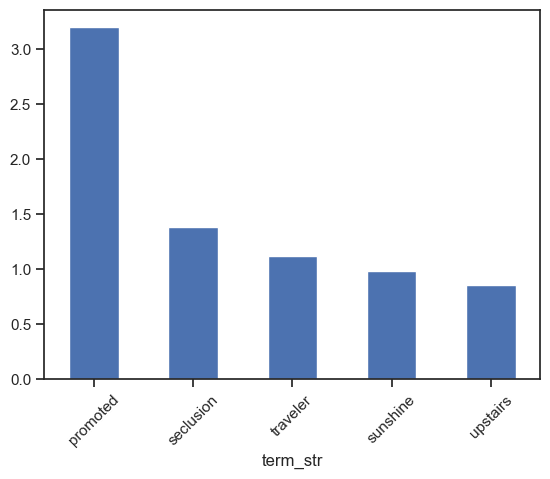

In [34]:
EIG_PAIRS.exp_var.sort_values(ascending=False).head().plot.bar(rot=45);

## Pick Top K (10) Components

We pick these based on explained variance.

In [35]:
COMPS = EIG_PAIRS.sort_values('exp_var', ascending=False).head(10).reset_index(drop=True)
COMPS.index.name = 'comp_id'
COMPS.index = ["PC{}".format(i) for i in COMPS.index.tolist()]
COMPS.index.name = 'pc_id'

In [36]:
COMPS

,eig_val,home,cried,certain,looking,general,manner,felt,set,oh,...,breed,regretting,conference,attendant,upstairs,sunshine,traveler,seclusion,promoted,exp_var
pc_id,,,,,,,,,,,,,,,,,,,,,
PC0,0.029816,-0.044463,-0.005767,-0.003137,-0.014347,-0.031636,-0.035220,-0.058317,-0.008732,-0.031259,...,0.002636,-0.007773,-0.007306,-0.001022,-0.009871,-0.000131,0.003581,-0.001207,-0.000367,3.20
PC1,0.012965,-0.020328,0.023880,-0.009207,-0.024233,-0.013066,-0.012447,-0.003437,-0.021603,0.067908,...,-0.003003,-0.000998,-0.001630,-0.002524,-0.000614,-0.002531,0.004194,-0.000875,-0.003659,1.39
PC2,0.010423,0.012811,0.028893,-0.002045,0.001508,0.010835,0.004944,0.020201,0.007638,0.056866,...,-0.000432,0.000872,0.001648,-0.003297,0.003891,-0.003833,-0.004339,-0.001374,-0.004084,1.12
PC3,0.009244,-0.027175,-0.043355,0.003453,-0.043440,0.001873,-0.006673,-0.028717,-0.018382,-0.052701,...,-0.001530,0.000203,-0.001777,-0.000079,-0.001674,-0.002621,-0.000006,-0.002527,-0.002824,0.99
PC4,0.007973,-0.017814,-0.009600,-0.002679,-0.029988,-0.013672,-0.010628,-0.027987,-0.012172,-0.016936,...,-0.002316,-0.002025,-0.003044,-0.011253,-0.001633,-0.006443,-0.004979,-0.002003,-0.000649,0.86
PC5,0.006196,0.000698,-0.120057,-0.005698,-0.045901,0.022177,0.003675,0.015584,-0.007160,-0.085628,...,-0.003333,0.003964,0.001465,-0.002820,-0.001084,-0.004278,-0.010981,-0.004910,0.000010,0.66
PC6,0.005725,-0.016586,-0.075198,-0.004334,0.038046,-0.012815,-0.006209,-0.000536,-0.003669,-0.002634,...,-0.010190,-0.002162,-0.000482,0.000518,-0.000111,-0.005405,-0.005797,-0.000221,-0.008388,0.61
PC7,0.005281,0.011436,0.053605,-0.041934,-0.023017,-0.051584,-0.012806,0.012012,-0.003946,0.012995,...,-0.001915,0.001065,0.003498,-0.000593,0.003981,-0.000760,-0.007758,-0.001540,-0.007006,0.57
PC8,0.004545,0.006154,-0.011771,-0.025993,0.029943,-0.006482,-0.011293,-0.036870,-0.002972,0.025758,...,-0.009240,-0.006342,-0.003295,-0.001387,-0.000836,0.002810,0.000269,0.001161,0.003041,0.49


## See Projected Components onto Vocabulary (Loadings)

Loadings sow the contribution of each term to the component. \
We'll just look at the topi 10 words for the first two components in the Book version.

In [37]:
LOADINGS = COMPS[COV.index].T
LOADINGS.index.name = 'term_str'

In [38]:
LOADINGS.head(10).style.background_gradient(cmap=colors)

pc_id,PC0,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9
term_str,,,,,,,,,,
home,-0.044463,-0.020328,0.012811,-0.027175,-0.017814,0.000698,-0.016586,0.011436,0.006154,0.001272
cried,-0.005767,0.023880,0.028893,-0.043355,-0.009600,-0.120057,-0.075198,0.053605,-0.011771,-0.050104
certain,-0.003137,-0.009207,-0.002045,0.003453,-0.002679,-0.005698,-0.004334,-0.041934,-0.025993,0.005370
looking,-0.014347,-0.024233,0.001508,-0.043440,-0.029988,-0.045901,0.038046,-0.023017,0.029943,0.017634
general,-0.031636,-0.013066,0.010835,0.001873,-0.013672,0.022177,-0.012815,-0.051584,-0.006482,0.028480
manner,-0.035220,-0.012447,0.004944,-0.006673,-0.010628,0.003675,-0.006209,-0.012806,-0.011293,-0.006251
felt,-0.058317,-0.003437,0.020201,-0.028717,-0.027987,0.015584,-0.000536,0.012012,-0.036870,0.051812
set,-0.008732,-0.021603,0.007638,-0.018382,-0.012172,-0.007160,-0.003669,-0.003946,-0.002972,-0.012024
oh,-0.031259,0.067908,0.056866,-0.052701,-0.016936,-0.085628,-0.002634,0.012995,0.025758,-0.024881


In [39]:
top_terms = []
for i in range(10):
    for j in [0, 1]:
        comp_str = ' '.join(LOADINGS.sort_values(f'PC{i}', ascending=bool(j)).head(10).index.to_list())
        top_terms.append((f"PC{i}", j, comp_str))
COMP_GLOSS = pd.DataFrame(top_terms).set_index([0,1]).unstack()
COMP_GLOSS.index.name = 'comp_id'
COMP_GLOSS.columns = COMP_GLOSS.columns.droplevel(0) 
COMP_GLOSS = COMP_GLOSS.rename(columns={0:'pos', 1:'neg'})

In [40]:
COMP_GLOSS

1,pos,neg
comp_id,,
PC0,whale thou sea ye ship deck thee boat thy whales,am sister dear think letter had mother do wish...
PC1,thou thee thy hath art oh hast brother thine ye,whale ship deck sailors boat mate sea ships wa...
PC2,whale whales thou thee boat ye boats ship thy ...,natives valley cosmopolitan doctor island isla...
PC3,whale whales cosmopolitan fish oil tail acquai...,thou thee deck thy ship sailors mate ye jacket...
PC4,cosmopolitan deck war jacket officers sailors ...,valley natives island islanders fruit trees ca...
PC5,thee thou mother thy officers daughter natives...,lord said dont ye cosmopolitan wine cried ha y...
PC6,cosmopolitan doctor dont natives confidence co...,lord war beard officers kings isle frigate dem...
PC7,boat ye sail canoe sea reef breeze sails prow ...,war whale american book cosmopolitan officers ...
PC8,doctor room ladies whale town street dance din...,cosmopolitan boat confidence nature philosophy...


In [46]:
# COMPS.join(COMP_GLOSS)

## Project Docs onto Components

We get the dot product of the DTM matrix and the new component matrix, which we will call DCM -- for document-component matrix. \
This has the effect of replacing the features of the DTM with the features of the transposed component matrix.

In [47]:
# We use the index to get only PC features, so matrices align
# DCM = TFIDF_L2.dot(COMPS[COV.index].T) 

In [41]:
# We use the index to get only PC features, so matrices align
DCM = TFIDF_L2.dot(LOADINGS) 

We add metadata to our new, reduced matrices for display purposes.

In [42]:
DCM = DCM.join(LIB[LIB_COLS], on='book_id')

We define a `doc` field to name each chapter.

In [43]:
DCM['doc'] = DCM.apply(lambda x: f"{x.label} {str(x.name[1]).zfill(2)}", 1)

In [44]:
DCM.doc

book_id  chap_id
105      1                         Austen: Persuasion (105) 01
         2                         Austen: Persuasion (105) 02
         3                         Austen: Persuasion (105) 03
         4                         Austen: Persuasion (105) 04
         5                         Austen: Persuasion (105) 05
                                       ...                    
34970    110        Melville: Pierre Or The Ambigu (34970) 110
         111        Melville: Pierre Or The Ambigu (34970) 111
         112        Melville: Pierre Or The Ambigu (34970) 112
         113        Melville: Pierre Or The Ambigu (34970) 113
         114        Melville: Pierre Or The Ambigu (34970) 114
Name: doc, Length: 1183, dtype: object

In [45]:
DCM

PC0       PC1       PC2       PC3       PC4       PC5  \
book_id chap_id                                                               
105     1       -0.330894 -0.059815  0.070145 -0.053910 -0.103361  0.052895   
        2       -0.316074 -0.068286  0.075268 -0.064258 -0.110127  0.036659   
        3       -0.306866 -0.108130  0.105710 -0.167202 -0.090909 -0.080671   
        4       -0.320347 -0.056875  0.077886 -0.061142 -0.101426  0.063629   
        5       -0.422743 -0.103776  0.124907 -0.162899 -0.164669 -0.079119   
...                   ...       ...       ...       ...       ...       ...   
34970   110      0.058496  0.156639  0.161323 -0.218278 -0.149778  0.014785   
        111     -0.018658  0.171068  0.145224 -0.198307 -0.097860 -0.036862   
        112      0.003678  0.003524  0.054516 -0.130943 -0.114291 -0.070593   
        113      0.034055  0.259233  0.148297 -0.193098 -0.082186 -0.008526   
        114      0.041993  0.161371  0.144285 -0.261166 -0.110047 -0.043535   

                      PC6       PC7       PC8       PC9            author  \
book_id chap_id                                                             
105     1       -0.116715 -0.112526 -0.051612  0.094040      AUSTEN, JANE   
        2       -0.065727 -0.089665 -0.113048  0.001473      AUSTEN, JANE   
        3       -0.108080 -0.149235 -0.034239 -0.031327      AUSTEN, JANE   
        4       -0.096050 -0.083647 -0.170989  0.025450      AUSTEN, JANE   
        5       -0.045793 -0.086784  0.007705  0.025466      AUSTEN, JANE   
...                   ...       ...       ...       ...               ...   
34970   110      0.012610  0.006682 -0.099517  0.009324  MELVILLE, HERMAN   
        111      0.017391 -0.113995 -0.029611  0.084303  MELVILLE, HERMAN   
        112     -0.010148 -0.043107 -0.003776  0.089761  MELVILLE, HERMAN   
        113     -0.031667 -0.075612 -0.005571  0.049961  MELVILLE, HERMAN   
        114      0.009997 -0.065637 -0.029903  0.027194  MELVILLE, HERMAN   

                                     title  \
book_id chap_id                              
105     1                       PERSUASION   
        2                       PERSUASION   
        3                       PERSUASION   
        4                       PERSUASION   
        5                       PERSUASION   
...                                    ...   
34970   110      PIERRE OR THE AMBIGUITIES   
        111      PIERRE OR THE AMBIGUITIES   
        112      PIERRE OR THE AMBIGUITIES   
        113      PIERRE OR THE AMBIGUITIES   
        114      PIERRE OR THE AMBIGUITIES   

                                                  label     genre  \
book_id chap_id                                                     
105     1                      Austen: Persuasion (105)  domestic   
        2                      Austen: Persuasion (105)  domestic   
        3                      Austen: Persuasion (105)  domestic   
        4                      Austen: Persuasion (105)  domestic   
        5                      Austen: Persuasion (105)  domestic   
...                                                 ...       ...   
34970   110      Melville: Pierre Or The Ambigu (34970)    gothic   
        111      Melville: Pierre Or The Ambigu (34970)    gothic   
        112      Melville: Pierre Or The Ambigu (34970)    gothic   
        113      Melville: Pierre Or The Ambigu (34970)    gothic   
        114      Melville: Pierre Or The Ambigu (34970)    gothic   

                          mode                                         doc  
book_id chap_id                                                             
105     1              romance                 Austen: Persuasion (105) 01  
        2              romance                 Austen: Persuasion (105) 02  
        3              romance                 Austen: Persuasion (105) 03  
        4              romance                 Austen: Persuasion (105) 04  
        5              romance   

/apps/software/standard/core/jupyterlab/3.6.3-py3.11/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


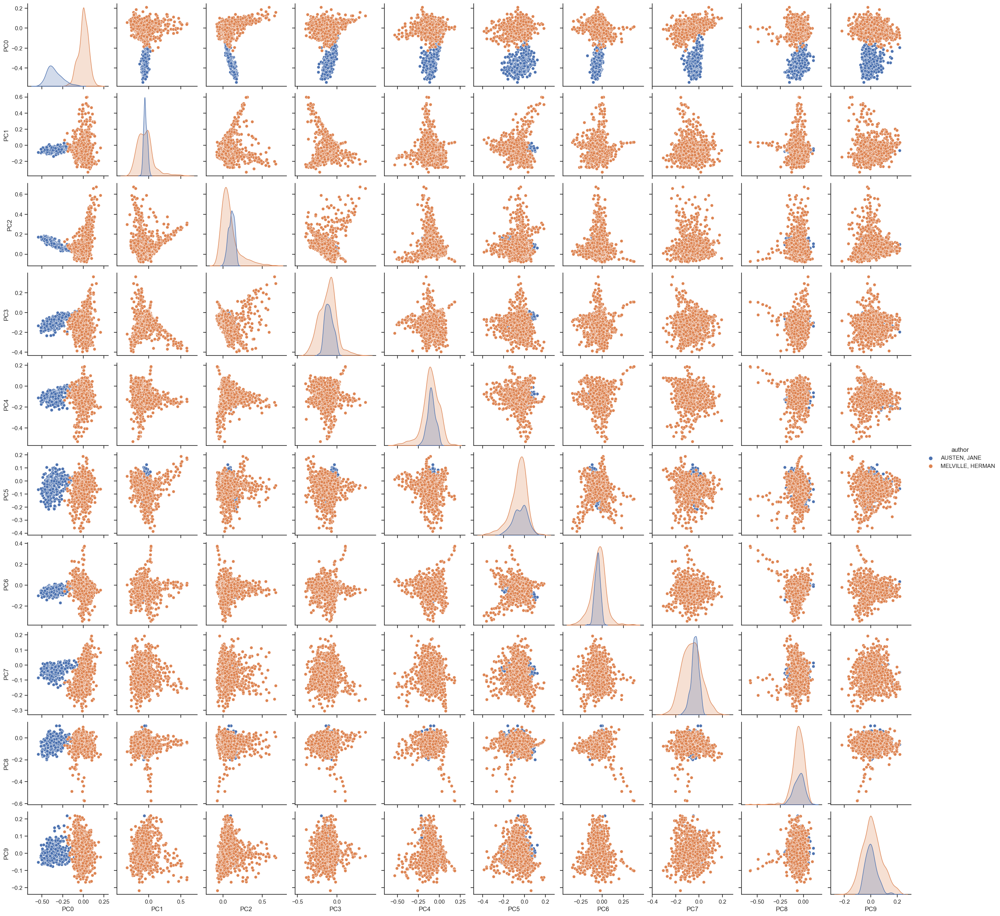

In [46]:
sns.pairplot(DCM.iloc[:, :], hue='author')

# Visualize

In [47]:
def vis_pcs(M, a, b, label='author', hover_name='doc', symbol=None, size=None):
    return px.scatter(M, f"PC{a}", f"PC{b}", color=label, hover_name=hover_name, 
                     symbol=symbol, size=size,
                     marginal_x='box', height=800)

In [48]:
def vis_loadings(a=0, b=1, hover_name='term_str'):
    # X = LOADINGS.join(VOCAB)
    X = LOADINGS.join(VSHORT)
    return px.scatter(X.reset_index(), f"PC{a}", f"PC{b}", 
                      text='term_str', size='i', color='max_pos_group', 
                      marginal_x='box', height=800)

## PC 0 and 1

### Author

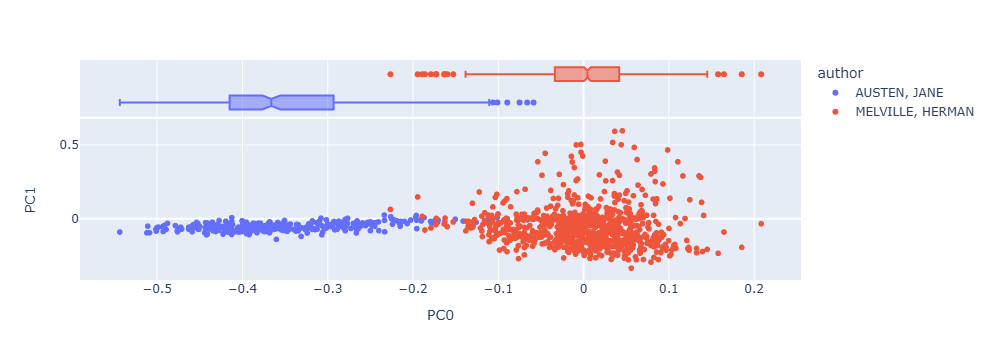

In [49]:
vis_pcs(DCM, 0, 1)

### Loadings

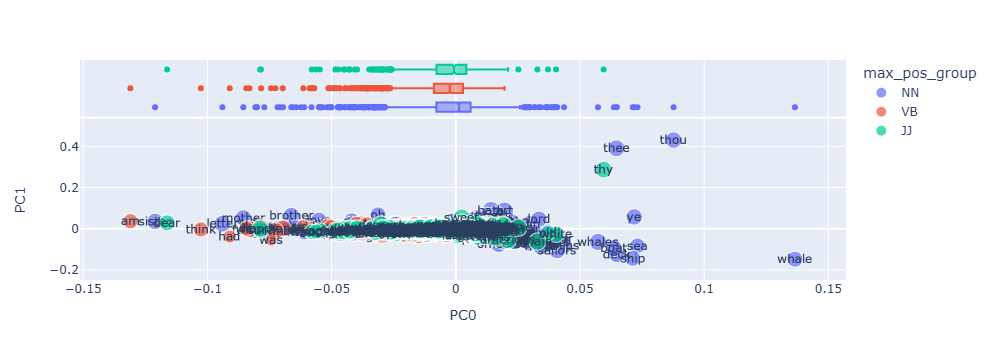

In [86]:
vis_loadings(0,1)

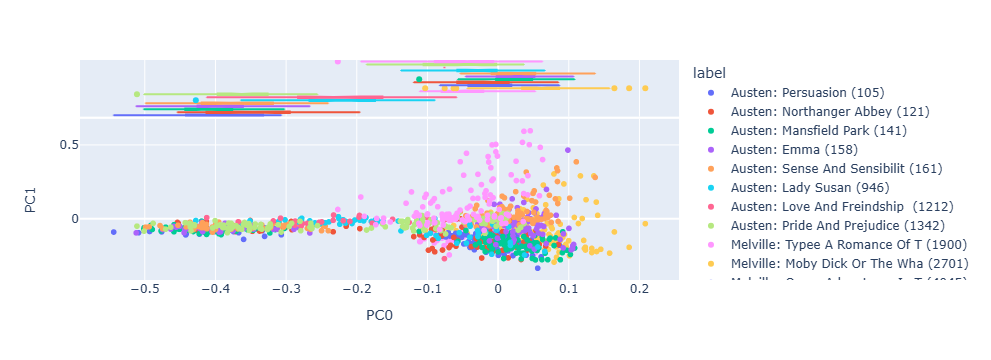

In [87]:
vis_pcs(DCM, 0, 1, label='label')

### Genre

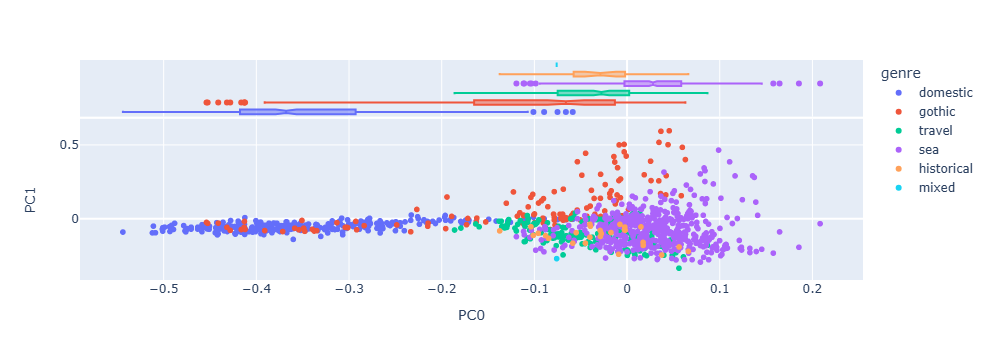

In [88]:
vis_pcs(DCM, 0, 1, label='genre')

### Mode

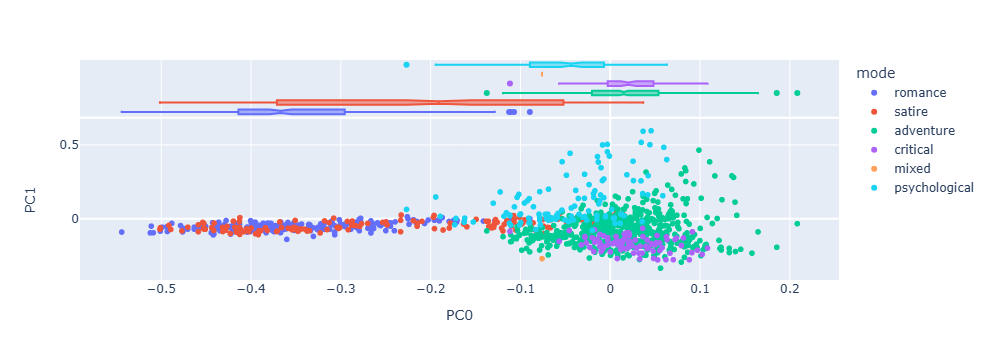

In [89]:
vis_pcs(DCM, 0, 1, label='mode')

### Title

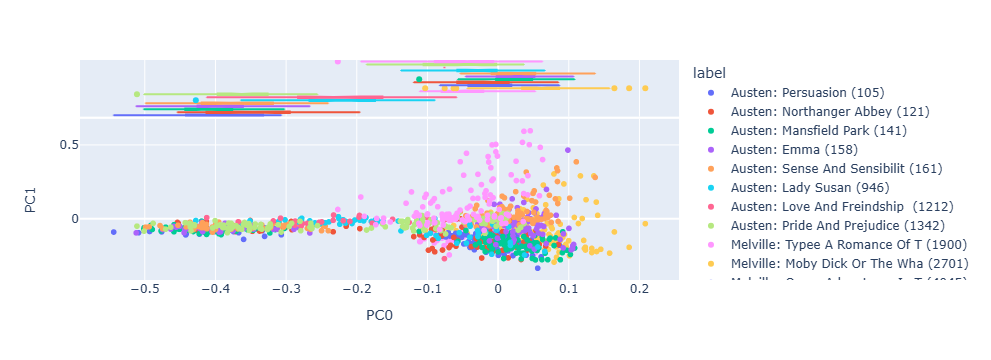

In [90]:
vis_pcs(DCM, 0, 1, label='label')

## PC 1 and 2

### Author

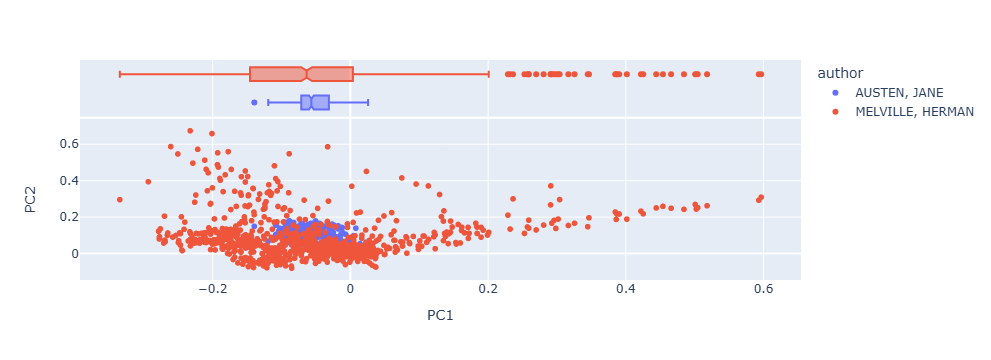

In [91]:
vis_pcs(DCM, 1, 2)

### Loadings

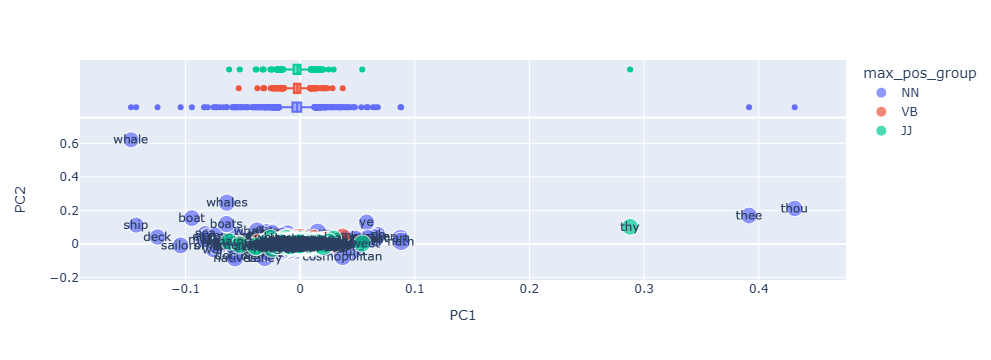

In [92]:
vis_loadings(1, 2)

### Genre

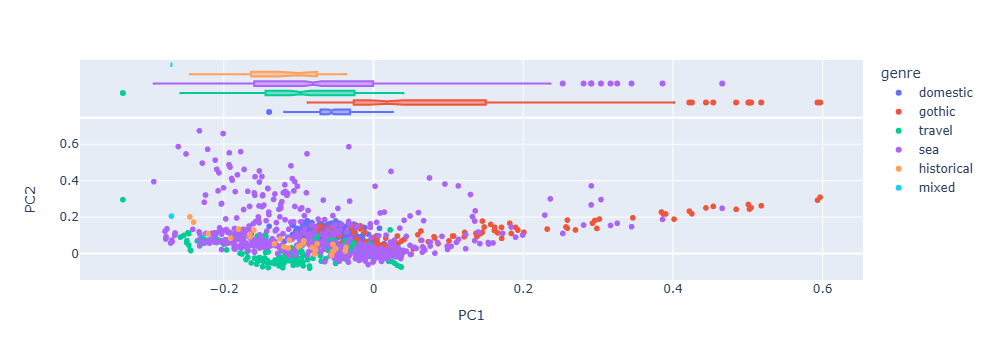

In [93]:
vis_pcs(DCM, 1, 2, label='genre')

### Mode

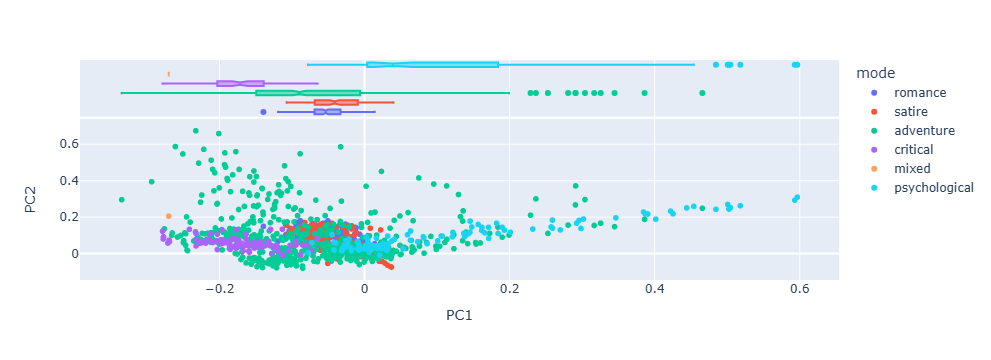

In [94]:
vis_pcs(DCM, 1, 2, label='mode')

### Title

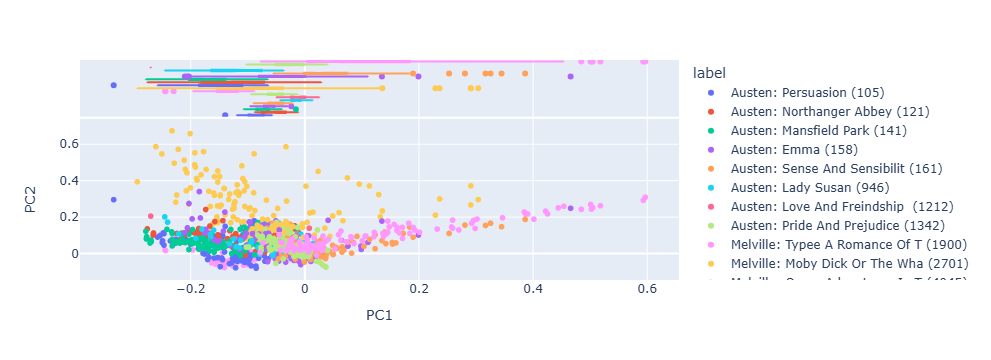

In [95]:
vis_pcs(DCM, 1, 2, label='label')

## PC 2 and 3

### Author

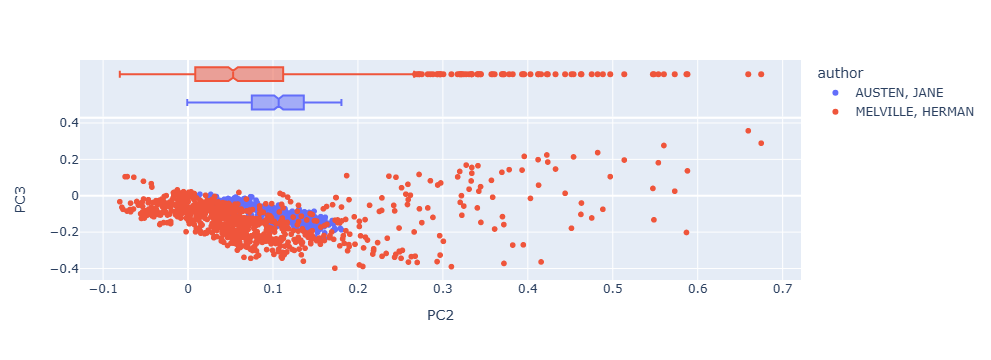

In [96]:
vis_pcs(DCM, 2, 3)

### Loadings

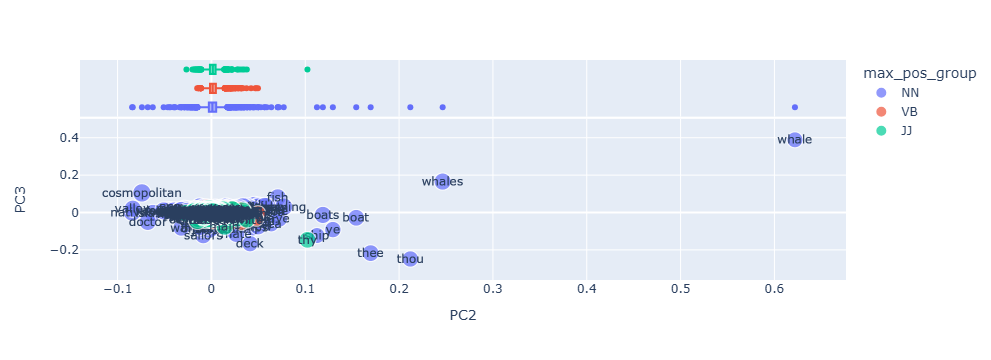

In [97]:
vis_loadings(2, 3)

### Genre

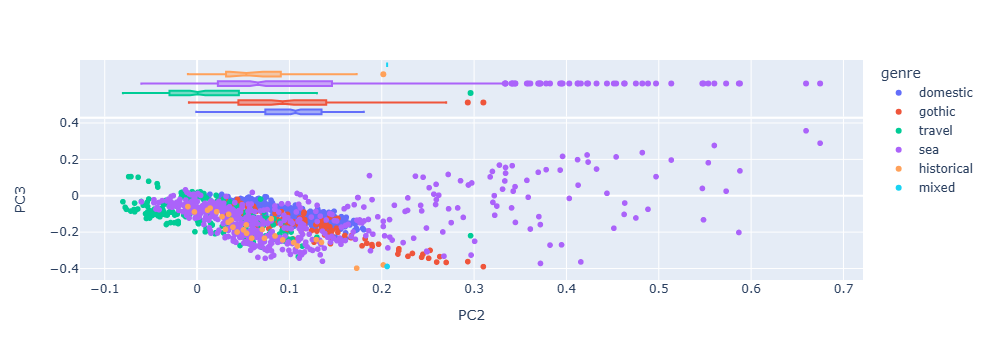

In [98]:
vis_pcs(DCM, 2, 3, label='genre')

### Mode

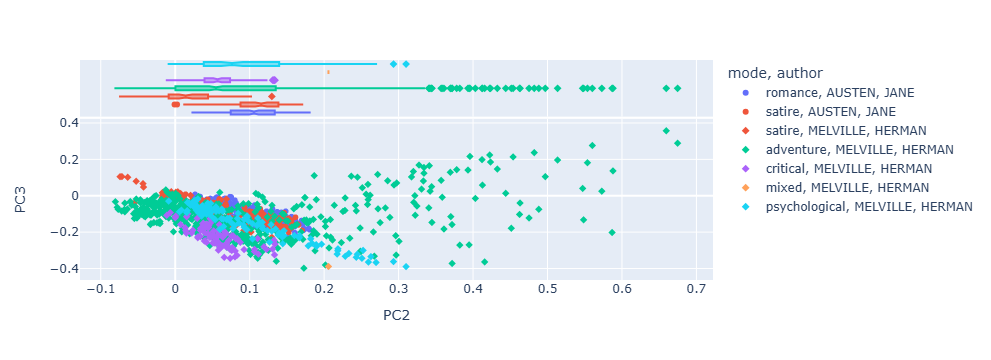

In [99]:
vis_pcs(DCM, 2, 3, label='mode', symbol='author')

### Title

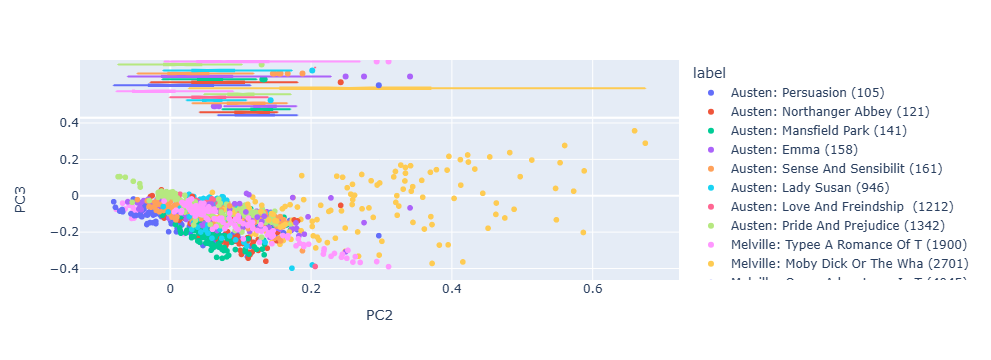

In [100]:
vis_pcs(DCM, 2, 3, label='label')

## PC 3 and 4

### Author

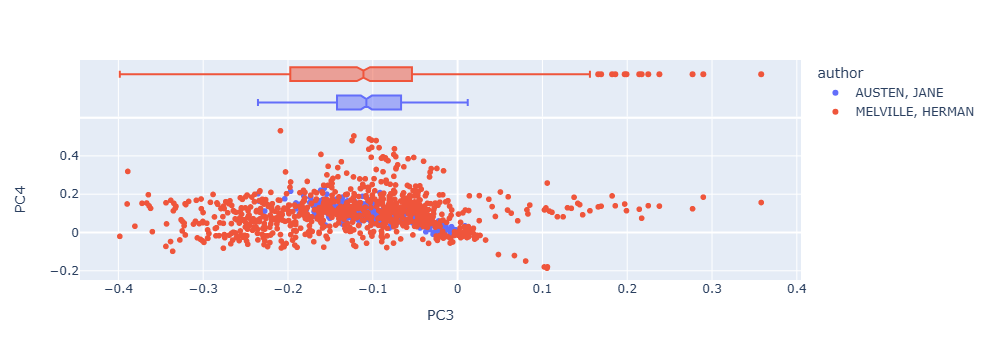

In [101]:
vis_pcs(DCM, 3, 4, label='author')

### Loadings

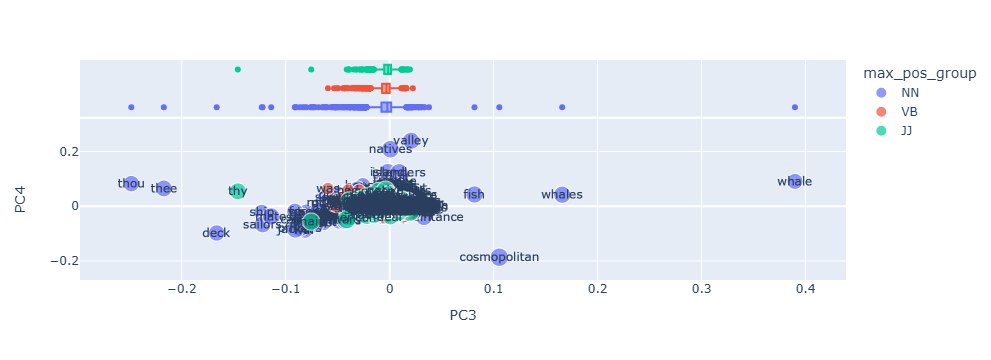

In [102]:
vis_loadings(3, 4)

### Genre

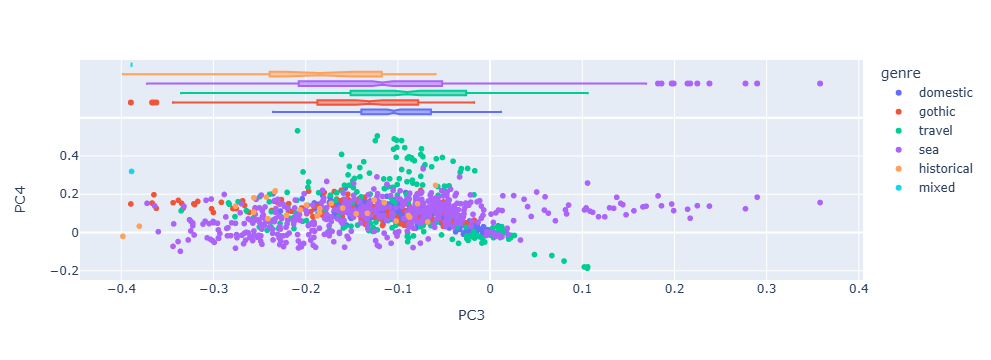

In [103]:
vis_pcs(DCM, 3, 4, label='genre')

### Mode

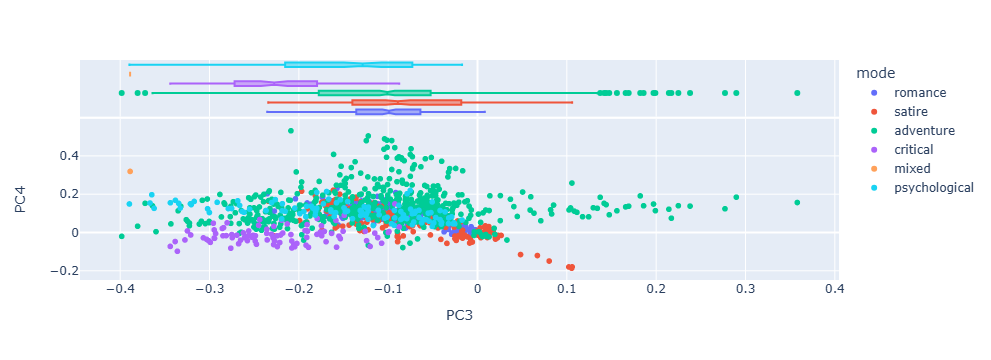

In [104]:
vis_pcs(DCM, 3, 4, label='mode')

### Title

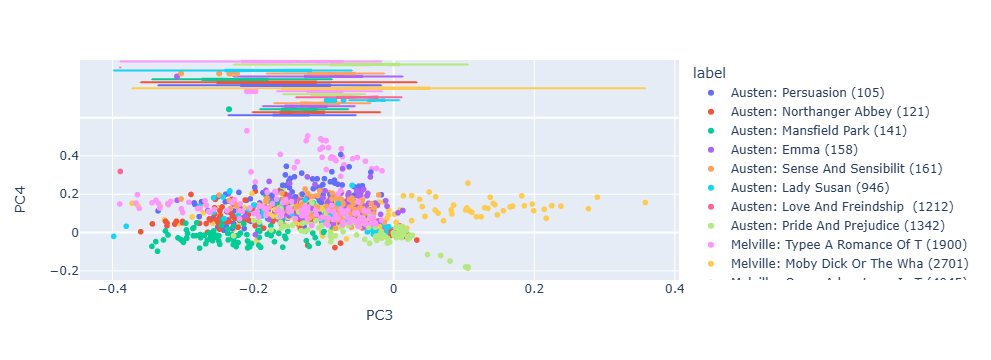

In [105]:
vis_pcs(DCM, 3, 4, label='label')

## Dendrograms

In [106]:
import sys
sys.path.append(local_lib)
from hac2 import HAC

In [107]:
X = DCM[COMPS.index].groupby('book_id').mean()
titles = LIB.loc[list(X.index)].apply(lambda x: x.label + ' ' + x.genre.upper(), 1)
X.index = titles

<Axes: >

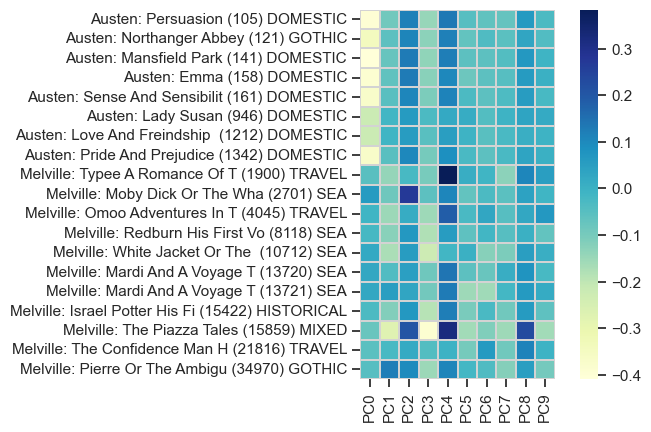

In [108]:
sns.heatmap(X, cmap='YlGnBu', square=True, linewidths=.01, linecolor='lightgray')

<Figure size 640x480 with 0 Axes>

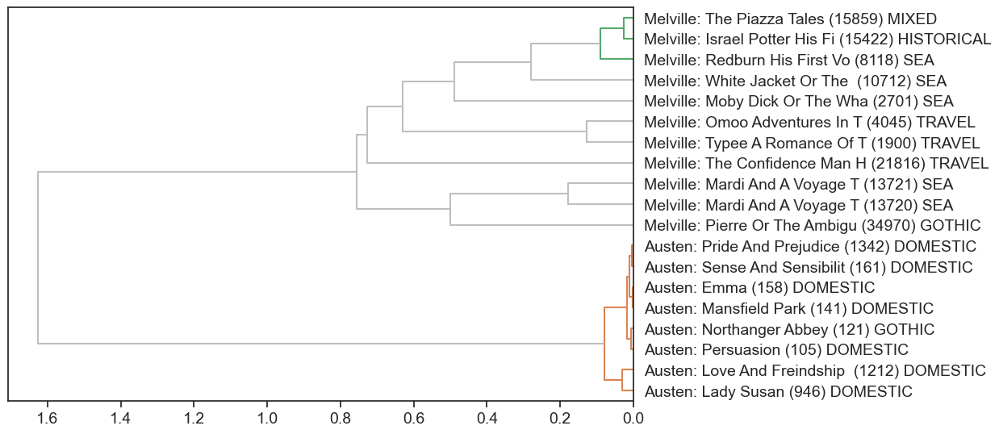

In [109]:
HAC(X).plot();

In [110]:
XV = LOADINGS.loc[VSHORT.sort_values('dfidf', ascending=False).head(100).index]

<Figure size 640x480 with 0 Axes>

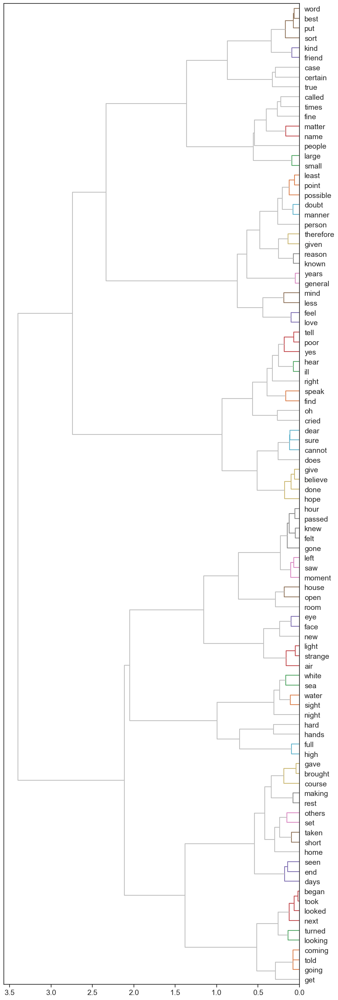

In [111]:
HAC(XV).plot()

In [82]:
XV2 = LOADINGS.loc[VSHORT.sample(50).index]

<Figure size 640x480 with 0 Axes>

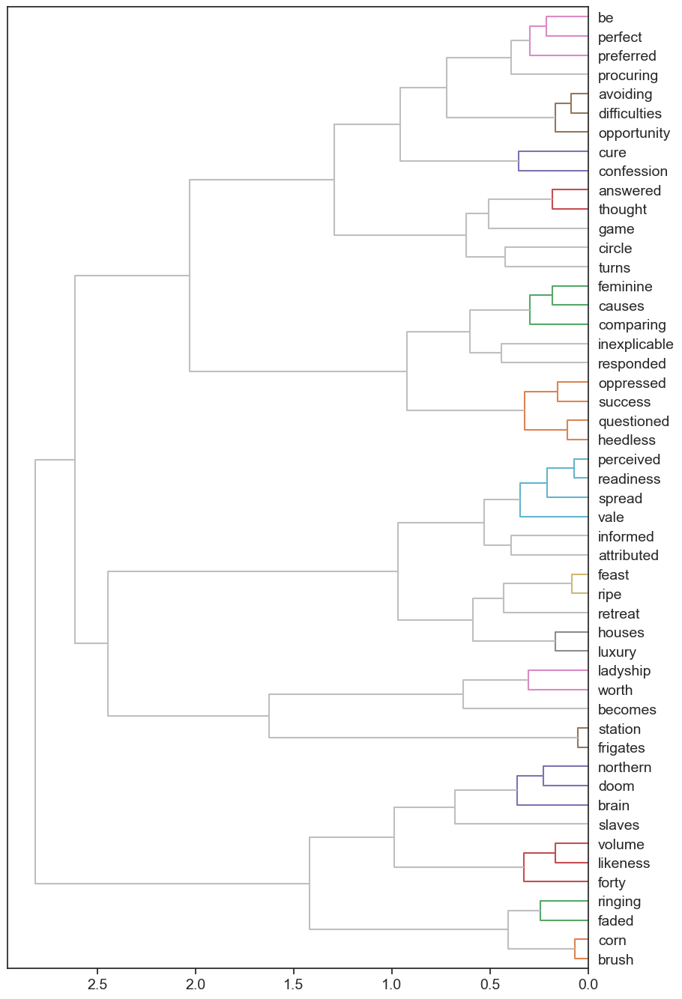

In [83]:
HAC(XV2).plot()

# SAVE

In [50]:
# TFIDF.to_csv(f"{output_dir}/{data_prefix}-TFIDF_chap.csv")
TFIDF_L2.to_csv(f"{output_dir}/{data_prefix}-TFIDF_chap_L2.csv")
DCM.iloc[:,:10].to_csv(f"{output_dir}/{data_prefix}-PCA_DCM_chap.csv")
COMPS.iloc[:,[0,-1]].to_csv(f"{output_dir}/{data_prefix}-PCA_COMPS_chap.csv")
LOADINGS.to_csv(f"{output_dir}/{data_prefix}-PCA_TCM_chap.csv")